<h1> Interpolation for Raster Timeseries (Sentinel-2) </h1>
<p> A lot of applications of satellite imagery based analysis makes use of the fact that the data is available in regular temporal intervals, in  order to detect change and development over time. Especially for Sensors based on wavelengths of the electromagnetic spectrum, that are within or close to the visible light, cloud cover is one of the main issues limiting analysis to fewer samples. 
If the value generated from the imagery (e.g. % snow cover) is the only value of interest, this value can easily be interpolated from the available data before and after the missing file. If on the other hand the snow cover mask is only one of many features to be considered for a spatial analysis of the area of interest, the missing raster layer derived from the imagery could limit the spatial aspect of the analysis compared to a derrived value.</p>

Example:</br>
<p> This image can also be represented as a value of ~22% of snow cover for the given day. This value might be good enough for some use cases. But if you want to analyse the impact of snow cover in relationship to other spatial variables, the actual pixels within the image, that are covered by snow are relevant. Therefore this notebook provides a solution to generate the rasters for satellite scenes covered by clouds.</p>

</br>
<img src=sample_data\SanLorenzo_monthly\snow_mask.png alt="drawing" width="500"/>


In [20]:
# necessary Imports
import os
import numpy as np 
import matplotlib.pyplot as plt
import matplotlib.patches as patches
#import matplotlib.cm as cm
from IPython.display import Image

# geodata specific imports
import gdal
import rasterio
from rasterio.mask import mask
from geojson import Polygon

<h2> Imagery Time Series </h2>
<p> This GIF represents the monthly snow cover over the "Cerro San Lorenzo" on the border between Argentina and Chile in Patagonia. With a height of 3,706 metres the mountain top is covered in snow all year round and the surrounding area is mostly snow free during the summer month. As seen in the GIF many images are covered by clouds, which makes a calculation of snow cover impossible. </p>

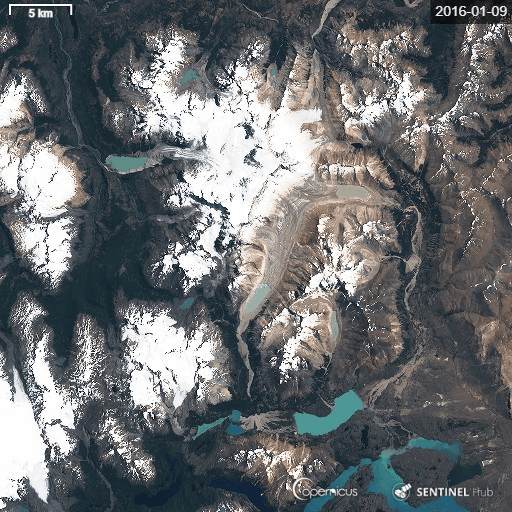

In [21]:
with open('sample_data/SanLorenzo_monthly/Sentinel-2_L1C-timelapse.gif','rb') as file:
    display(Image(file.read()))

<h2> Data preprocessing</h2>

In [22]:
# Normalize bands into 0.0 - 1.0 scale
def normalize(array):
    array_min, array_max = array.min(), array.max()
    return (array - array_min) / (array_max - array_min)

# calculate Normalized Difference Snow Index
def ndsi(scene):
    return (scene[1]- scene[4]) / (scene[1]+ scene[4])

# Generate binary mask for snow / no-snow pixels
def snowmask(ndsi_array):
    test_array = ndsi_array
    test_array[test_array >= 0.4] = 1
    test_array[test_array < 0.4] = np.nan
    return test_array

<h3> Open the Sentinel 2 Files and calculate Snow Index (NDSI) </h3>

In [23]:
aoi  = [Polygon([[(-8081300,-6021520), (-8029420, -6021520), (-8029420,-6063600), (-8081300, -6063600)]])]
print(aoi)

[{"coordinates": [[[-8081300, -6021520], [-8029420, -6021520], [-8029420, -6063600], [-8081300, -6063600]]], "type": "Polygon"}]


In [24]:
# open data sets

directory = "sample_data/SanLorenzo_monthly"
# loop over directory and open all single band tiffs

ndsi_list = []
name_list = []
tc_list = []

for subdir, dirs, files in os.walk(directory):
    for dir in dirs:
        name_list.append(dir[-7:])
        multiband =  []
        for filename in os.listdir(os.path.join(directory, dir)):
            #check if file is a tiff
            if filename.endswith(".tiff"): 
                file_path = os.path.join(directory, dir, filename)
                # open multiband tiff using Rasterio
                raster = rasterio.open(file_path)
                out_img, out_transform = mask(raster, shapes=aoi, crop=True)
                band = normalize(out_img[0])
                multiband.append(band)
                raster.close()
        ndsi_band = ndsi(multiband)
        ndsi_list.append(np.array(ndsi_band))

        trueColor = np.dstack((multiband[0], multiband[1], multiband[2]))
        tc_list.append(trueColor)


ndsi_array = np.array(ndsi_list)
name_array = np.array(name_list)
trueColor_array = np.array(tc_list)
input_array = np.copy(ndsi_array)
print(f" Files for the time span {name_list[0]} to {name_list[-1]} were loaded sucessfully. " )


Files for the time span 2015_10 to 2018_12 were loaded sucessfully. 


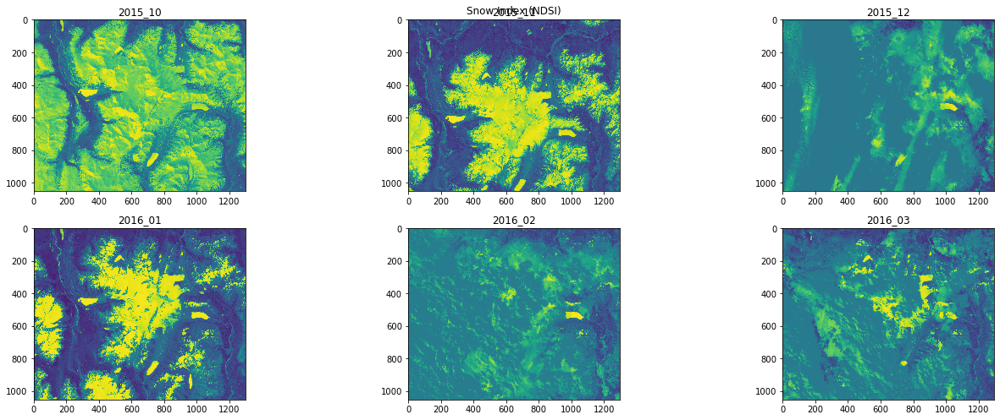

In [25]:
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20,7))

fig.subplots_adjust(hspace=0.5)
fig.suptitle('Snow Index (NDSI)')

for ax, array, name in zip(axes.flatten(), ndsi_array, name_array):
    ax.imshow(array)
    ax.set(title=name)

plt.tight_layout()

<h3> Delete Datasets with heavy cloud cover </h3>
In this setp, the scenes covered by clouds will be deleted, as the snow index calculated on these images will be wrong and will distort the time series

In [9]:
# delete images with too many clouds
# create list of Bands to Keep
img_delete = ['2015_12', '2016_02', '2016_04', '2016_07', '2016_11', '2016_12', '2017_03', '2017_06', '2017_07', '2017_08', '2017_09', '2018_01', '2018_04', '2018_08', '2018_11']

# create filter based on list this will return a True-False array in the shape of the MultiBand array stating "True" for the elements to keep
img_filter = np.isin(name_array, img_delete)

# use filter to reduce oridinal multiband array 
ndsi_array[img_filter] *= 0

<h3> Calculate snow cover masks </h3>

Now that cloud covered images are removed, the snow mask can be calulated for the remaining scenes

In [10]:
snow_cover = []
for array in ndsi_array:
    perc_snow = np.count_nonzero(~np.isnan(snowmask(array))) / (array.shape[0]*array.shape[1])
    snow_cover.append(perc_snow)

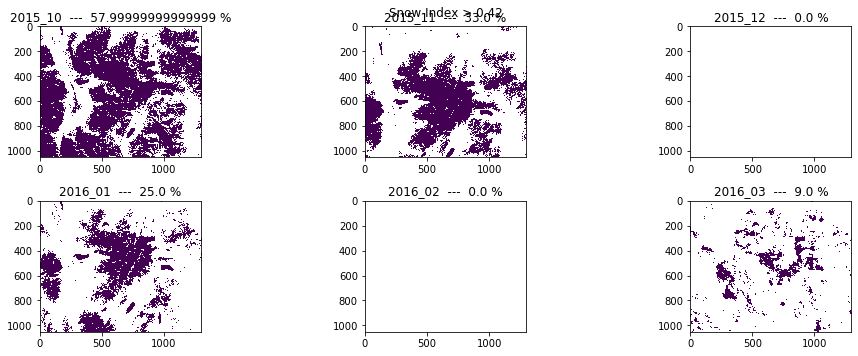

In [14]:
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(20,5))

fig.subplots_adjust(hspace=0.5)
fig.suptitle('Snow Index > 0.42')

for ax, array, name , cover in zip(axes.flatten(), ndsi_array, name_array, snow_cover):
    ax.imshow(snowmask(array))
    ax.set(title=str(name+ '  ---  '+ str(round(cover, 2)*100)+ ' %'))
    plt.tight_layout()

plt.tight_layout()


<h2> Interpolation of missing data </h2>
The missing data will now be interpolated. First the total value within each scene weill be calulated (percent of snow mask pixels in frame), then the missing data will be interpolated using spline Interpolation, as this interpolation methed allows for extraplating and fits the yearly development nicly.

In [15]:
X = np.array([x for x in range(len(snow_cover))])
y = np.array(snow_cover)
y[y == 0] = np.nan

In [16]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from scipy.interpolate import CubicSpline

idx_finite = np.isfinite(y)
cs = CubicSpline(X[idx_finite], y[idx_finite])




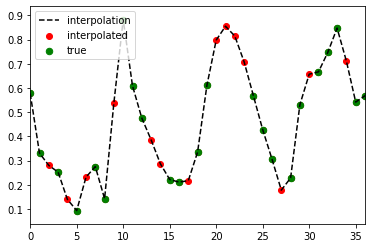

In [17]:
# fit curve to data to interpolate snow amount for missing month
# make rast regions grow until value is reached
plt.scatter(X,cs(X), color="red", label="interpolated")
plt.scatter(X,y, c="green", s=42, label="true")
plt.plot(X,cs(X), '--', c='black', label="interpolation")
plt.xlim(0, 36)
plt.legend(loc='upper left')

<h3> Transferring the interpolation to the raster </h3>
Now that the missing values are interpolated, the missing raster will be generated. For this, the existing rasters will be taken and the snow regions will be increased or decread until the interpolated value is reached. To do so, the edges within the snow mask will be detected and the boundary pixels will be changed to "snow" pixels to increase the area or to "no snow" pixels to decrease the area.

In [118]:
y_pred = cs(X)


<h4> Function to detect boundary pixels</h4>

In [120]:

def find_edge_outside(array):
    borders = np.zeros(array.shape)
    # iterate through each value
    for i in range(array.shape[0]):
        for j in range(array.shape[1]):
            # select those which are in class 1
            if np.isnan(array[i,j]):
                # get slice of all adjacent pixels
                slice = array[i-1:i+1,j-1:j+1]
                # check if any belong to class 2
                if np.any(slice == 1):
                    # update borders array
                    borders[i-1:i+1,j-1:j+1] = 1

    return borders

def find_edge_inside(array):
    borders = np.zeros(array.shape)
    # iterate through each value
    for i in range(array.shape[0]):
        for j in range(array.shape[1]):
            # select those which are in class 1
            if array[i,j] == 1:
                
                # get slice of all adjacent pixels
                slice = array[i-1:i+1,j-1:j+1]
                # check if any belong to class 2
                if np.isnan(slice).any():
                    # update borders array
                    borders[i-1:i+1,j-1:j+1] = 1

    return borders

<h4> Function to grow or shrink snow areas</h4>

In [121]:
from scipy import ndimage
from skimage import measure

def interpolate_raster(X, y, ypred, array):

    # open snow mask array with missing scenes
    work_array = np.copy(array)

    # loop thourgh scenes
    for i in range(0, len(X)):

        # if scene for this month is empty start filling
        if np.isnan(y[i]):

            # check if distance to previous or next snow value is smaller
            if abs(ypred[i] - ypred[i-1]) < abs(ypred[i+1] - ypred[i]) or (np.isnan(y[i+1])):

                # if previous data point is closer and smaller, start growing from here
                if ypred[i-1] < ypred[i]:

                    # set interpolated percentage value as goal
                    goal = y_pred[i]

                    # set previouse raster mask as start array
                    start_array = work_array[i-1]
                    start_array = snowmask(start_array)

                    # calculate current percentige of snow cover
                    perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    while perc < goal:
                        
                        # find border pixels and fill them
                        borders = find_edge_outside(start_array)
                        start_array = np.where(borders ==1, 1, start_array)

                        # calulate new snow percentage and continue if still lower than goal
                        perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    
                    #replace missing raster through new raster
                    work_array[i] = start_array

                # esle previous snow cover is bigger than prediction, needs to shrink
                else:

                    #set goal snow cover percentage
                    goal = y_pred[i]
                    start_array = work_array[i-1]
                    start_array = snowmask(start_array)

                    #calcualate current snow cover
                    perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    while perc > goal:
                        
                        # find border pixels and set to no-snow to shrink
                        borders = find_edge_inside(start_array)
                        start_array = np.where(borders == 1, np.nan, start_array)
                        # check new snow cover to see if prediction is met
                        perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    
                    work_array[i] = start_array

            # the same loop if the next data point is closer to the prediction than the previous
            else: 
                if ypred[i+1] < ypred[i]:
                    goal = y_pred[i]
                    print("Goal: ", round(goal,2))
                    start_array = work_array[i+1]
                    start_array = snowmask(start_array)
                    perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    while perc < goal:

                        borders = find_edge_outside(start_array)
                        start_array = np.where(borders ==1, 1, start_array)
                        perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    
                    work_array[i] = start_array

                
                elif ypred[i+1] > ypred[i]:
                    goal = y_pred[i]
                    print("goal: ", round(goal,2))
                    start_array = work_array[i+1]
                    start_array = snowmask(start_array)
                    perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    while perc > goal:

                        borders = find_edge_inside(start_array)
                        start_array = np.where(borders == 1, np.nan, start_array)
                        perc = np.count_nonzero(~np.isnan(snowmask(start_array))) / (start_array.shape[0]*start_array.shape[1])
                    
                    work_array[i] = start_array
                
                else: 
                    work_array[i] = work_array[i-1]

        
    return work_array
            

In [122]:
# use function to interpolated missing rasters
interpolated_array = interpolate_raster(X, y, y_pred, ndsi_array)

2015_10
2015_11
2015_12
Goal:  0.28
2016_01
2016_02
Goal:  0.14
2016_03
2016_04
goal:  0.23
2016_05
2016_06
2016_07
goal:  0.54
2016_08
2016_09
2016_10
2016_11
goal:  0.38582013630905604
2016_12
Goal:  0.29
2017_01
2017_02
2017_03
Goal:  0.2171151434673208
2017_04
2017_05
2017_06
Goal:  0.7974178370568215
2017_07
Goal:  0.8547453110257677
2017_08
goal:  0.8143052665602455
2017_09
goal:  0.7079935198075377
2017_10
2017_11
2017_12
2018_01
goal:  0.18
2018_02
2018_03
2018_04
goal:  0.66
2018_05
2018_06
2018_07
2018_08
goal:  0.7106449787290353
2018_09
2018_10
2018_11
Goal:  0.5731391401404775
2018_12


<h2> Visualisation of results </h2>
Now the full time series of snow masks can be visualised. The red framed scenes show interpolated snow masks.

In [ ]:
from matplotlib import cm
fig, axes = plt.subplots(nrows=12, ncols=3, figsize=(20,50))
fig.subplots_adjust(hspace=0.5)

for ax, mask_array, array, name, yy in zip(axes.flatten(), interpolated_array, trueColor_array, name_array, y):
    ax.imshow(array)
    ax.imshow(mask_array, alpha=0.5, cmap='cool')
    if np.isnan(yy):

        rect = patches.Rectangle((0,0),array.shape[1],array.shape[0], linewidth=6,edgecolor='r',facecolor='none')
        ax.add_patch(rect)     

    ax.set(title=name)
    
plt.tight_layout()
plt.savefig("plots/Interpolated_SnowIndex.png")

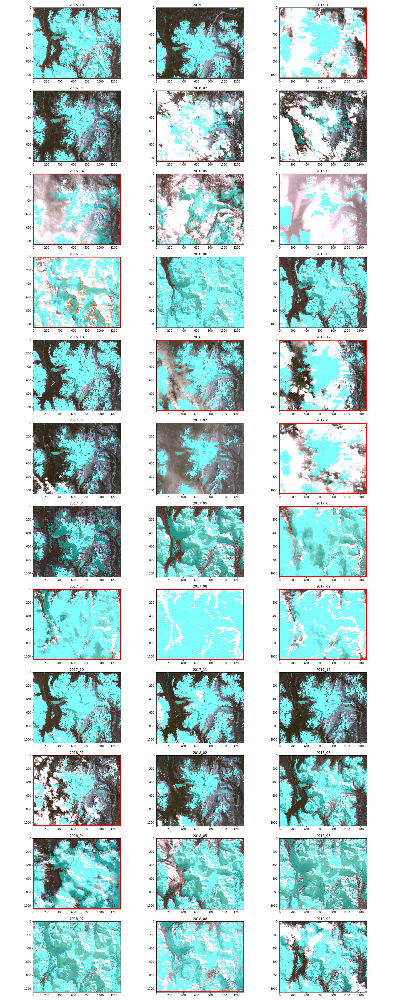

In [19]:
with open('plots/Interpolated_SnowIndex.png','rb') as file:
    display(Image(file.read()))